# **YOLOv8**

In [ ]:
!nvidia-smi

Wed Apr 10 21:23:07 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off | 00000000:00:04.0 Off |                    0 |
| N/A   31C    P0              43W / 400W |      2MiB / 40960MiB |      0%      Default |
|                                         |                      |             Disabled |
+-----------------------------------------+----------------------+--

In [ ]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 750.4/750.4 kB 14.5 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-man

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
# check the uploaded dataset
!ls '/content/drive/My Drive/side-body-final'
!ls '/content/drive/My Drive/side-body-final/train'
!ls '/content/drive/My Drive/side-body-final/valid'

Mounted at /content/drive
data.yaml  test  train	valid
images	labels
images	labels


In [ ]:
import timeit
from ultralytics import YOLO

start = timeit.default_timer()

model = YOLO("yolov8n.pt")
yaml_file = "/content/drive/My Drive/side-body-final/data.yaml"
results = model.train(data=yaml_file, epochs=100, imgsz=320)  # train the model

stop = timeit.default_timer()
print('Head detector Runtime (seconds): ', stop - start)

100%|██████████| 6.23M/6.23M [00:00<00:00, 304MB/s]


Ultralytics YOLOv8.1.46 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/drive/My Drive/side-body-final/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, sh

100%|██████████| 755k/755k [00:00<00:00, 117MB/s]


Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

train: Scanning /content/drive/My Drive/side-body-final/train/labels... 1914 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1914/1914 [03:07<00:00, 10.20it/s]


train: New cache created: /content/drive/My Drive/side-body-final/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/drive/My Drive/side-body-final/valid/labels... 146 images, 12 backgrounds, 0 corrupt: 100%|██████████| 146/146 [00:10<00:00, 13.51it/s]

val: New cache created: /content/drive/My Drive/side-body-final/valid/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      1.06G      1.564      1.855       1.39         55        320: 100%|██████████| 120/120 [00:15<00:00,  7.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  2.53it/s]

                   all        146        423      0.741      0.681      0.752      0.397



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      1.06G       1.51      1.289      1.364         66        320: 100%|██████████| 120/120 [00:10<00:00, 11.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.93it/s]

                   all        146        423      0.806      0.679      0.772      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      1.06G      1.508      1.272      1.373         38        320: 100%|██████████| 120/120 [00:10<00:00, 11.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.51it/s]

                   all        146        423       0.76      0.633      0.687      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      1.06G      1.526      1.227      1.382         52        320: 100%|██████████| 120/120 [00:10<00:00, 11.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.05it/s]

                   all        146        423      0.761      0.709      0.736      0.366



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      1.06G       1.48      1.194      1.362         37        320: 100%|██████████| 120/120 [00:10<00:00, 11.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.71it/s]

                   all        146        423      0.853      0.726      0.813      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      1.06G      1.459      1.146       1.33         48        320: 100%|██████████| 120/120 [00:10<00:00, 11.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.79it/s]

                   all        146        423      0.809      0.709      0.804      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      1.06G      1.449      1.122       1.34         54        320: 100%|██████████| 120/120 [00:10<00:00, 11.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.66it/s]

                   all        146        423      0.833      0.757      0.828      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      1.06G      1.422       1.08      1.325         81        320: 100%|██████████| 120/120 [00:10<00:00, 11.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.27it/s]

                   all        146        423      0.825      0.689      0.729      0.362



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      1.06G      1.397      1.049      1.299         82        320: 100%|██████████| 120/120 [00:10<00:00, 11.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.63it/s]

                   all        146        423       0.87      0.762      0.842      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      1.06G      1.398      1.032      1.304         47        320: 100%|██████████| 120/120 [00:10<00:00, 11.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.17it/s]

                   all        146        423      0.872      0.766      0.849      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      1.06G      1.369     0.9922      1.284         64        320: 100%|██████████| 120/120 [00:10<00:00, 11.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.61it/s]

                   all        146        423      0.906      0.793      0.877      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      1.06G      1.358     0.9965      1.284         51        320: 100%|██████████| 120/120 [00:10<00:00, 11.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.61it/s]

                   all        146        423      0.889      0.754      0.841      0.491



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      1.06G      1.342      0.963      1.269         69        320: 100%|██████████| 120/120 [00:10<00:00, 11.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.98it/s]

                   all        146        423      0.886      0.769      0.852      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      1.06G      1.322     0.9479       1.27         67        320: 100%|██████████| 120/120 [00:10<00:00, 11.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.81it/s]

                   all        146        423      0.909      0.766      0.861       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      1.06G      1.327     0.9482      1.271         46        320: 100%|██████████| 120/120 [00:10<00:00, 11.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.31it/s]

                   all        146        423      0.882      0.796      0.859       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      1.06G      1.298     0.9139      1.248         60        320: 100%|██████████| 120/120 [00:10<00:00, 11.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.92it/s]

                   all        146        423      0.888      0.776      0.843      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      1.06G      1.296     0.9125      1.243         57        320: 100%|██████████| 120/120 [00:10<00:00, 11.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.33it/s]

                   all        146        423      0.849      0.779      0.837      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      1.06G      1.289     0.8942      1.241         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.11it/s]

                   all        146        423      0.857      0.781      0.861      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      1.06G      1.265     0.8602      1.228         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.36it/s]

                   all        146        423      0.878      0.778       0.86      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      1.06G      1.244     0.8643      1.225         34        320: 100%|██████████| 120/120 [00:10<00:00, 11.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.48it/s]

                   all        146        423      0.885       0.79      0.882      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      1.06G      1.252     0.8488       1.22         42        320: 100%|██████████| 120/120 [00:10<00:00, 11.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.14it/s]

                   all        146        423      0.924      0.793      0.881      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      1.06G      1.255     0.8421      1.229         56        320: 100%|██████████| 120/120 [00:10<00:00, 11.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.11it/s]

                   all        146        423      0.885       0.79      0.858      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      1.06G      1.237     0.8282      1.215         52        320: 100%|██████████| 120/120 [00:10<00:00, 11.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.96it/s]

                   all        146        423      0.898      0.783      0.849       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      1.06G      1.218     0.8201      1.207         73        320: 100%|██████████| 120/120 [00:10<00:00, 11.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.70it/s]

                   all        146        423      0.888      0.808      0.889      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      1.06G      1.225     0.8146      1.207         75        320: 100%|██████████| 120/120 [00:10<00:00, 11.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.14it/s]

                   all        146        423      0.895      0.771      0.854      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      1.06G      1.214     0.7869      1.196         58        320: 100%|██████████| 120/120 [00:10<00:00, 11.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.28it/s]

                   all        146        423      0.869      0.796      0.866       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      1.06G      1.189     0.7966       1.19         41        320: 100%|██████████| 120/120 [00:10<00:00, 11.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.57it/s]

                   all        146        423      0.878      0.804       0.88      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      1.06G      1.182     0.7872      1.188         50        320: 100%|██████████| 120/120 [00:10<00:00, 11.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.55it/s]

                   all        146        423      0.885      0.809      0.885      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      1.06G      1.187     0.7786      1.187         55        320: 100%|██████████| 120/120 [00:10<00:00, 11.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.19it/s]

                   all        146        423      0.866      0.817      0.881      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      1.06G       1.16     0.7581      1.172         59        320: 100%|██████████| 120/120 [00:09<00:00, 12.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.20it/s]

                   all        146        423      0.858      0.817      0.871      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      1.06G      1.178     0.7698      1.182         63        320: 100%|██████████| 120/120 [00:10<00:00, 11.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.51it/s]

                   all        146        423      0.919      0.761      0.858      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      1.06G      1.167     0.7589       1.18         68        320: 100%|██████████| 120/120 [00:10<00:00, 11.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.55it/s]

                   all        146        423      0.917      0.753      0.859      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      1.06G      1.173     0.7625       1.17         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.48it/s]


                   all        146        423       0.88       0.81      0.868      0.536

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      1.06G      1.161     0.7503      1.172         35        320: 100%|██████████| 120/120 [00:10<00:00, 11.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.23it/s]

                   all        146        423      0.885      0.814      0.886       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      1.06G      1.135     0.7432      1.161         67        320: 100%|██████████| 120/120 [00:10<00:00, 11.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.49it/s]

                   all        146        423      0.885      0.795      0.877      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      1.06G       1.14     0.7357      1.155         44        320: 100%|██████████| 120/120 [00:10<00:00, 11.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.39it/s]

                   all        146        423      0.915      0.791      0.885      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      1.06G      1.165     0.7365      1.168         64        320: 100%|██████████| 120/120 [00:10<00:00, 11.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.57it/s]

                   all        146        423      0.892        0.8       0.86      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      1.06G      1.147     0.7361      1.163         66        320: 100%|██████████| 120/120 [00:10<00:00, 11.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.82it/s]

                   all        146        423      0.897        0.8       0.87      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      1.06G      1.126     0.7245       1.15         43        320: 100%|██████████| 120/120 [00:10<00:00, 11.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.20it/s]

                   all        146        423      0.899        0.8      0.866      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      1.06G      1.124     0.7158      1.153         69        320: 100%|██████████| 120/120 [00:10<00:00, 11.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.27it/s]

                   all        146        423       0.89      0.801      0.867      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      1.06G      1.103     0.7084      1.147         55        320: 100%|██████████| 120/120 [00:10<00:00, 11.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.64it/s]

                   all        146        423      0.894      0.795      0.883      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      1.06G      1.107     0.7043      1.135         51        320: 100%|██████████| 120/120 [00:10<00:00, 11.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.43it/s]

                   all        146        423      0.859      0.814      0.874       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      1.06G       1.09     0.7007      1.137         66        320: 100%|██████████| 120/120 [00:10<00:00, 11.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.97it/s]

                   all        146        423      0.867       0.82      0.867      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      1.06G      1.094     0.6971      1.144         39        320: 100%|██████████| 120/120 [00:10<00:00, 11.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.87it/s]

                   all        146        423      0.876      0.792      0.849      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      1.06G      1.101     0.6977      1.137         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.81it/s]

                   all        146        423      0.939      0.778      0.884      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      1.06G      1.072     0.6855      1.133         75        320: 100%|██████████| 120/120 [00:10<00:00, 11.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.70it/s]

                   all        146        423      0.912      0.787      0.877      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      1.06G       1.07     0.6822      1.129         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.65it/s]

                   all        146        423       0.88      0.804       0.87      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      1.06G      1.075     0.6667      1.125         52        320: 100%|██████████| 120/120 [00:10<00:00, 11.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.80it/s]

                   all        146        423      0.922      0.796      0.879      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      1.06G      1.055     0.6622      1.118         53        320: 100%|██████████| 120/120 [00:10<00:00, 11.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.09it/s]

                   all        146        423      0.926      0.781      0.878      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      1.06G      1.052     0.6632      1.123         66        320: 100%|██████████| 120/120 [00:10<00:00, 11.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.16it/s]

                   all        146        423      0.901      0.805      0.882      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      1.06G      1.056     0.6558      1.119         30        320: 100%|██████████| 120/120 [00:10<00:00, 11.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.40it/s]

                   all        146        423       0.94      0.773      0.868      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      1.06G      1.049     0.6554      1.121         69        320: 100%|██████████| 120/120 [00:10<00:00, 11.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.44it/s]

                   all        146        423      0.925      0.792      0.882       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      1.06G      1.039     0.6449      1.107         49        320: 100%|██████████| 120/120 [00:10<00:00, 11.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.42it/s]

                   all        146        423      0.937      0.786      0.877      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      1.06G      1.034     0.6394      1.106         51        320: 100%|██████████| 120/120 [00:10<00:00, 11.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.52it/s]

                   all        146        423      0.916      0.775      0.859      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      1.06G      1.028     0.6414      1.106         43        320: 100%|██████████| 120/120 [00:10<00:00, 11.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.62it/s]

                   all        146        423      0.912      0.788      0.877      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      1.06G      1.026     0.6271      1.104         62        320: 100%|██████████| 120/120 [00:10<00:00, 11.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.75it/s]

                   all        146        423      0.864      0.808       0.87      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      1.06G      1.029     0.6361      1.106         41        320: 100%|██████████| 120/120 [00:10<00:00, 11.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.87it/s]

                   all        146        423      0.903      0.806      0.879      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      1.06G      1.019     0.6265      1.097         50        320: 100%|██████████| 120/120 [00:10<00:00, 11.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.40it/s]

                   all        146        423      0.912      0.789      0.873      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      1.06G      1.013     0.6214      1.095         49        320: 100%|██████████| 120/120 [00:10<00:00, 11.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.55it/s]

                   all        146        423      0.911      0.798      0.882      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      1.06G          1     0.6167      1.089         63        320: 100%|██████████| 120/120 [00:10<00:00, 11.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.65it/s]

                   all        146        423      0.884      0.803      0.874      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      1.06G      1.009     0.6226      1.094         48        320: 100%|██████████| 120/120 [00:10<00:00, 11.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.18it/s]

                   all        146        423        0.9      0.817       0.88      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      1.06G     0.9893     0.6059      1.084         56        320: 100%|██████████| 120/120 [00:10<00:00, 11.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.88it/s]

                   all        146        423      0.893       0.79      0.877      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      1.06G     0.9784      0.602      1.081         48        320: 100%|██████████| 120/120 [00:10<00:00, 11.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.66it/s]

                   all        146        423      0.898      0.797      0.878      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      1.06G     0.9825     0.6089       1.08         66        320: 100%|██████████| 120/120 [00:10<00:00, 11.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.63it/s]

                   all        146        423      0.903      0.793      0.887      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      1.06G     0.9823     0.5962      1.078         72        320: 100%|██████████| 120/120 [00:10<00:00, 11.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.10it/s]

                   all        146        423      0.913        0.8      0.879      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      1.06G     0.9635     0.5969      1.075         40        320: 100%|██████████| 120/120 [00:10<00:00, 11.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.70it/s]

                   all        146        423      0.917      0.783      0.875      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      1.06G     0.9715      0.592      1.077         42        320: 100%|██████████| 120/120 [00:10<00:00, 11.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.87it/s]

                   all        146        423      0.925      0.767      0.865      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      1.06G     0.9527      0.579      1.072         50        320: 100%|██████████| 120/120 [00:10<00:00, 11.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.67it/s]

                   all        146        423      0.881       0.82      0.882      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      1.06G     0.9505     0.5793       1.07         57        320: 100%|██████████| 120/120 [00:10<00:00, 11.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  9.24it/s]


                   all        146        423      0.905      0.805      0.872      0.563

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      1.06G     0.9467     0.5781      1.071         36        320: 100%|██████████| 120/120 [00:10<00:00, 11.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.11it/s]


                   all        146        423      0.872      0.813      0.863      0.556

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      1.06G     0.9489     0.5799      1.065         60        320: 100%|██████████| 120/120 [00:10<00:00, 11.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.62it/s]

                   all        146        423      0.919      0.785      0.875      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      1.06G     0.9555     0.5844       1.07         74        320: 100%|██████████| 120/120 [00:10<00:00, 11.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.55it/s]

                   all        146        423      0.903      0.821      0.877       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      1.06G      0.942     0.5705      1.061         59        320: 100%|██████████| 120/120 [00:10<00:00, 11.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.92it/s]

                   all        146        423      0.908      0.798      0.879      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      1.06G     0.9347      0.576      1.064         70        320: 100%|██████████| 120/120 [00:10<00:00, 11.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.64it/s]

                   all        146        423       0.89      0.811      0.877      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      1.06G     0.9282     0.5602      1.058         38        320: 100%|██████████| 120/120 [00:10<00:00, 11.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.93it/s]

                   all        146        423      0.944      0.774      0.872      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      1.06G     0.9277     0.5582       1.06         65        320: 100%|██████████| 120/120 [00:10<00:00, 11.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.44it/s]

                   all        146        423      0.931      0.788      0.873      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      1.06G     0.9243     0.5664      1.057         60        320: 100%|██████████| 120/120 [00:10<00:00, 11.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.20it/s]

                   all        146        423      0.893      0.808      0.876      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      1.06G       0.93     0.5616      1.056         59        320: 100%|██████████| 120/120 [00:10<00:00, 11.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.85it/s]

                   all        146        423      0.904      0.801       0.88      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      1.06G     0.9168      0.551       1.05         56        320: 100%|██████████| 120/120 [00:10<00:00, 11.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.30it/s]

                   all        146        423      0.894      0.808      0.872      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      1.06G     0.9077     0.5426      1.048         52        320: 100%|██████████| 120/120 [00:10<00:00, 11.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.64it/s]

                   all        146        423      0.899      0.801      0.874      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      1.06G     0.9122     0.5521      1.054         47        320: 100%|██████████| 120/120 [00:10<00:00, 11.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.07it/s]

                   all        146        423      0.929      0.787      0.876      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      1.06G     0.9039     0.5503      1.046         80        320: 100%|██████████| 120/120 [00:10<00:00, 11.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.21it/s]

                   all        146        423      0.907      0.797      0.877      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      1.06G     0.8989     0.5378      1.042         56        320: 100%|██████████| 120/120 [00:10<00:00, 11.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.43it/s]

                   all        146        423      0.911      0.804       0.88      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      1.06G     0.8911     0.5425       1.04         40        320: 100%|██████████| 120/120 [00:10<00:00, 11.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.38it/s]

                   all        146        423      0.923      0.788      0.876       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      1.06G      0.896      0.546      1.044         43        320: 100%|██████████| 120/120 [00:10<00:00, 11.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.26it/s]

                   all        146        423      0.904      0.794      0.877      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      1.06G      0.885     0.5347      1.038         72        320: 100%|██████████| 120/120 [00:10<00:00, 11.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.92it/s]

                   all        146        423      0.905      0.793      0.872      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      1.06G     0.8805     0.5318       1.04         48        320: 100%|██████████| 120/120 [00:10<00:00, 11.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.46it/s]

                   all        146        423      0.899      0.806      0.876      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      1.06G     0.8805     0.5267      1.034         48        320: 100%|██████████| 120/120 [00:10<00:00, 11.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.95it/s]

                   all        146        423      0.925        0.8      0.878      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      1.06G     0.8785     0.5282      1.036         53        320: 100%|██████████| 120/120 [00:10<00:00, 11.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.75it/s]

                   all        146        423      0.917      0.807      0.877      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      1.06G     0.8642     0.5167      1.029         53        320: 100%|██████████| 120/120 [00:10<00:00, 11.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.83it/s]


                   all        146        423      0.912      0.802      0.879      0.577
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      1.06G     0.7789     0.3946     0.9765         18        320: 100%|██████████| 120/120 [00:11<00:00, 10.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.66it/s]

                   all        146        423      0.918      0.805       0.88      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      1.06G     0.7661     0.3836     0.9645         22        320: 100%|██████████| 120/120 [00:10<00:00, 11.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.21it/s]


                   all        146        423       0.92      0.812      0.884      0.575

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      1.06G     0.7487     0.3747     0.9548         23        320: 100%|██████████| 120/120 [00:10<00:00, 11.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.58it/s]

                   all        146        423      0.911      0.815      0.879      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      1.06G     0.7426     0.3707     0.9577         37        320: 100%|██████████| 120/120 [00:10<00:00, 11.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.17it/s]

                   all        146        423      0.908      0.821      0.882      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      1.06G     0.7489     0.3711     0.9581         19        320: 100%|██████████| 120/120 [00:10<00:00, 11.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.31it/s]

                   all        146        423      0.923      0.803      0.879      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      1.06G     0.7343     0.3683     0.9531         46        320: 100%|██████████| 120/120 [00:10<00:00, 11.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  7.61it/s]

                   all        146        423      0.919        0.8      0.882      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      1.06G     0.7317     0.3689      0.957         35        320: 100%|██████████| 120/120 [00:10<00:00, 11.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.04it/s]

                   all        146        423      0.925      0.797      0.878      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      1.06G     0.7366     0.3656     0.9516         43        320: 100%|██████████| 120/120 [00:10<00:00, 11.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.86it/s]

                   all        146        423        0.9      0.816      0.881       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      1.06G     0.7237     0.3629     0.9535         53        320: 100%|██████████| 120/120 [00:10<00:00, 11.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.32it/s]

                   all        146        423      0.911      0.812      0.879      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      1.06G     0.7144     0.3608     0.9464         57        320: 100%|██████████| 120/120 [00:10<00:00, 11.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  8.00it/s]

                   all        146        423      0.909      0.808       0.88      0.581



100 epochs completed in 0.314 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.1.46 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 168 layers, 3006038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.82it/s]


                   all        146        423      0.909      0.808      0.881      0.582
                  body        146        201      0.879      0.792      0.867      0.562
                  head        146        222      0.938      0.824      0.894      0.601
Speed: 0.0ms preprocess, 0.6ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to runs/detect/train
Head detector Runtime (seconds):  1358.7481301760001


In [ ]:
results = model.val()

Ultralytics YOLOv8.1.46 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 168 layers, 3006038 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/drive/My Drive/side-body-final/valid/labels.cache... 146 images, 12 backgrounds, 0 corrupt: 100%|██████████| 146/146 [00:00<?, ?it/s]
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  3.02it/s]


                   all        146        423      0.909      0.808      0.882      0.581
                  body        146        201      0.879      0.792       0.87      0.562
                  head        146        222      0.938      0.824      0.894      0.599
Speed: 0.1ms preprocess, 3.8ms inference, 0.0ms loss, 8.0ms postprocess per image
Results saved to runs/detect/train2


In [ ]:
model.info(detailed=True)

layer                                     name  gradient   parameters                shape         mu      sigma
    0                      model.0.conv.weight     False          432        [16, 3, 3, 3]     -0.136       3.74 torch.float32
    1                        model.0.conv.bias     False           16                 [16]       2.11       2.11 torch.float32
    2                      model.1.conv.weight     False         4608       [32, 16, 3, 3]   -0.00339      0.261 torch.float32
    3                        model.1.conv.bias     False           32                 [32]       1.83       2.05 torch.float32
    4                  model.2.cv1.conv.weight     False         1024       [32, 32, 1, 1]    -0.0183      0.108 torch.float32
    5                    model.2.cv1.conv.bias     False           32                 [32]       1.73          1 torch.float32
    6                  model.2.cv2.conv.weight     False         1536       [32, 48, 1, 1]   -0.00954      0.131 torch.float3

(168, 3006038, 0, 8.086272)

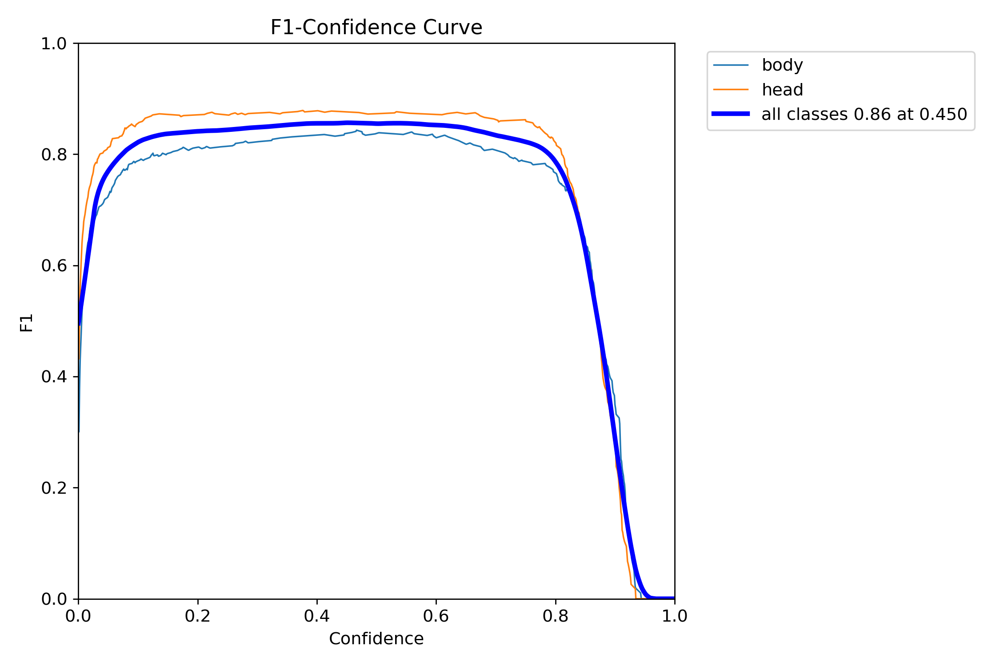

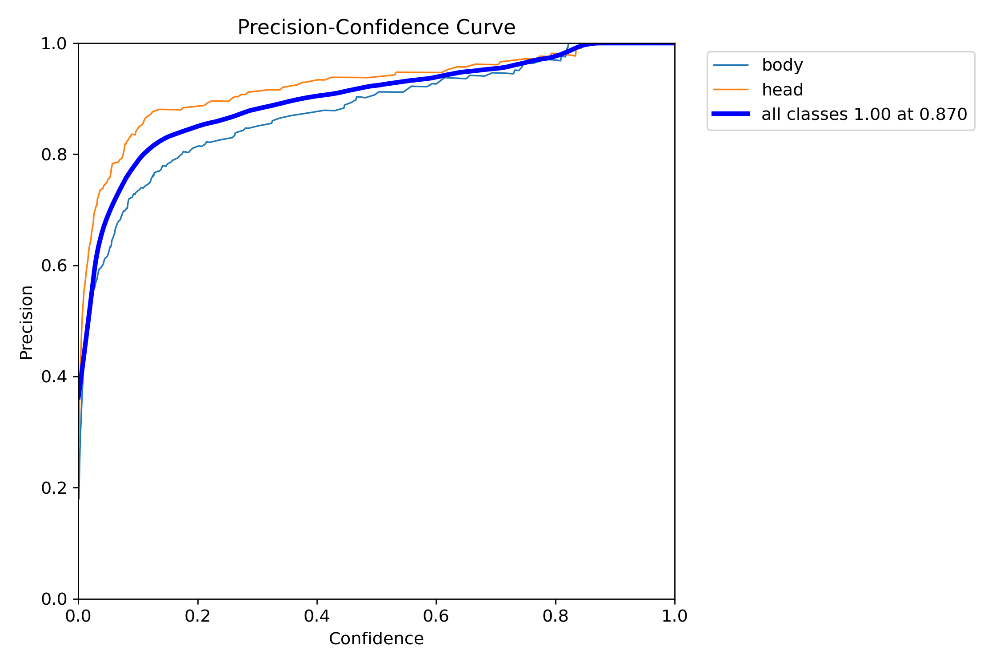

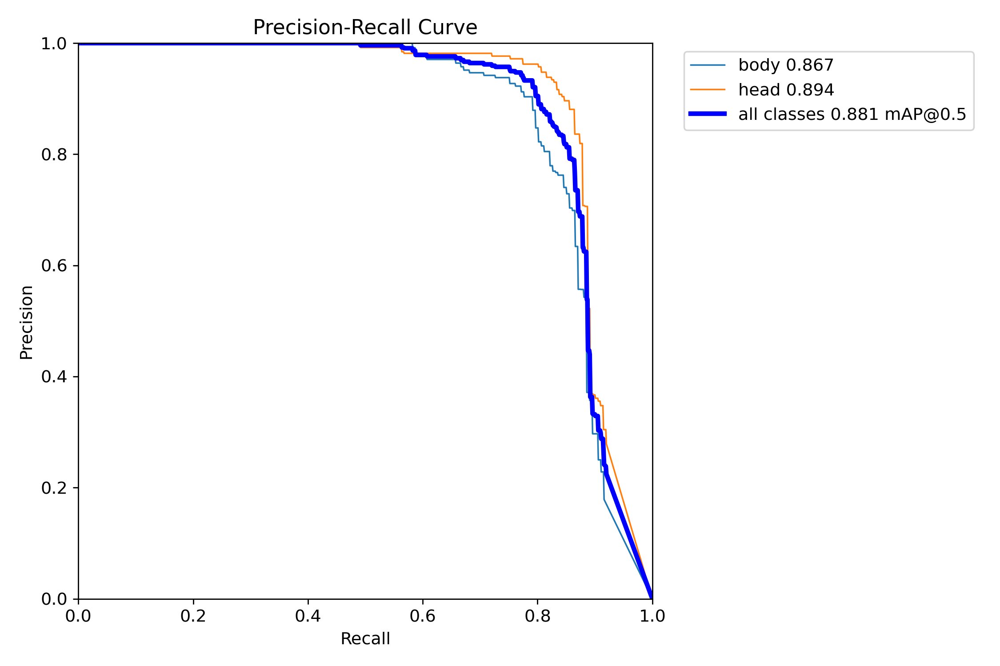

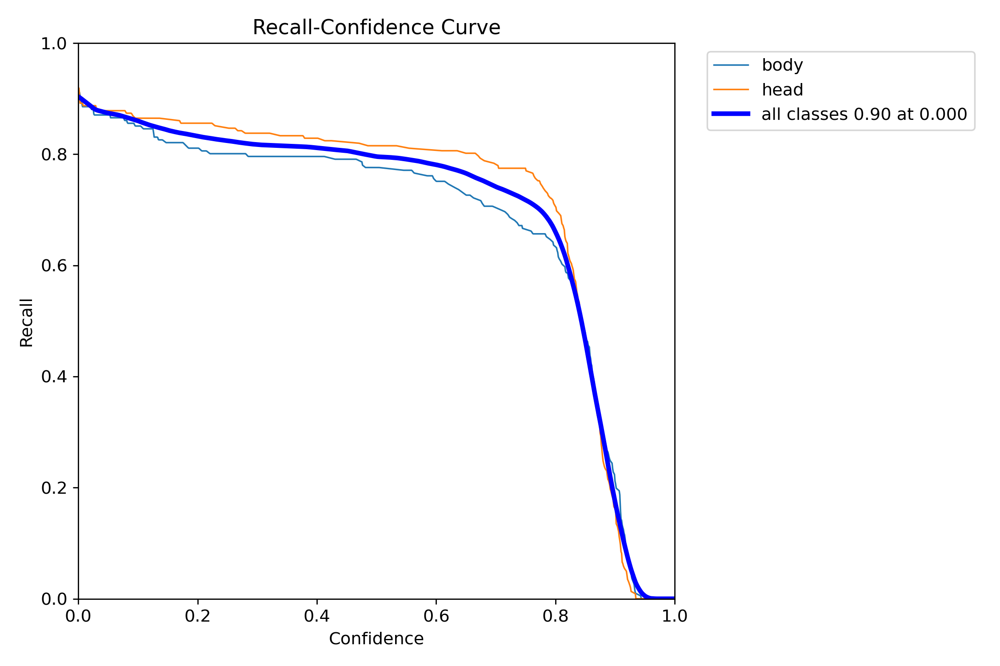

In [ ]:
# dislaying train data metrics

from IPython.display import Image
from IPython.display import display

x1 = Image(filename='runs/detect/train/F1_curve.png')
x2 = Image(filename='runs/detect/train/P_curve.png')
x3 = Image(filename='runs/detect/train/PR_curve.png')
x4 = Image(filename='runs/detect/train/R_curve.png')

display(x1, x2, x3, x4)

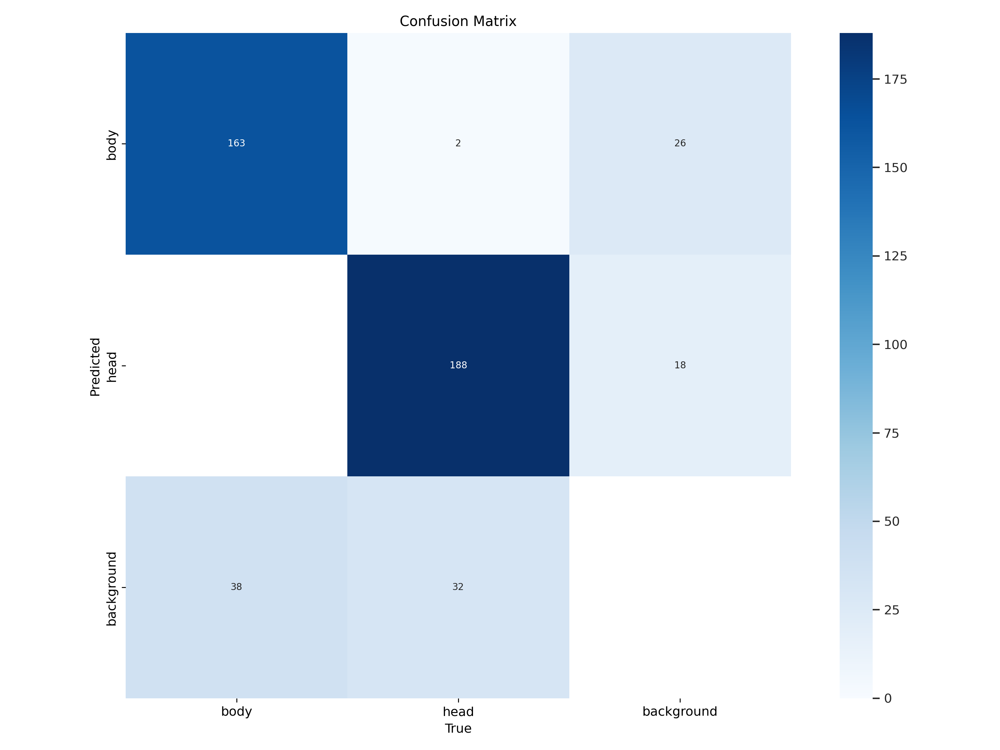

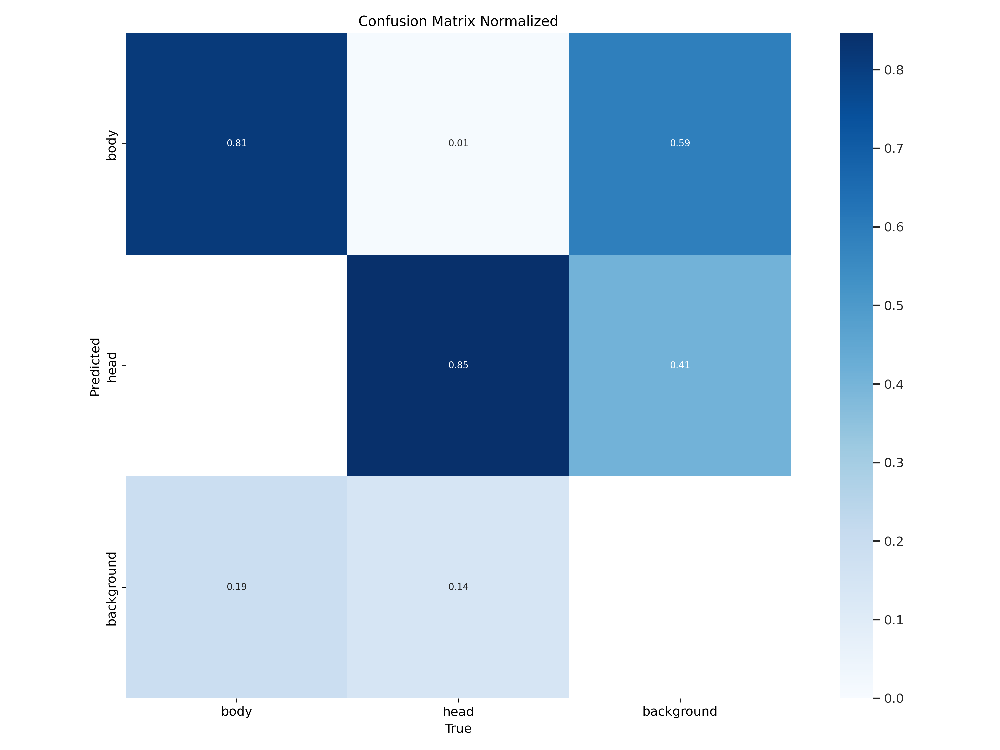

In [ ]:
y1 = Image(filename='runs/detect/train/confusion_matrix.png')
y2 = Image(filename='runs/detect/train/confusion_matrix_normalized.png')
display(y1, y2)

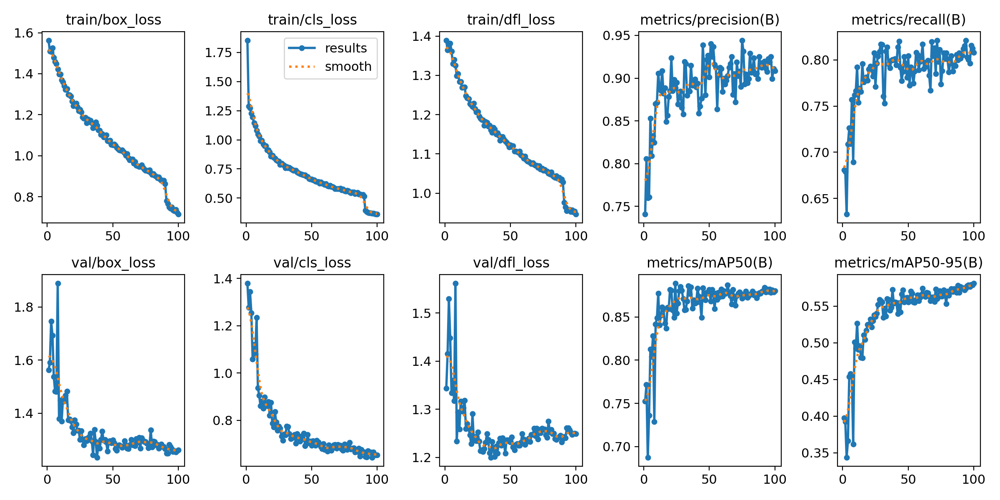

In [ ]:
Image(filename=f'/content/runs/detect/train/results.png', width = 600)

# **Model Weight and Analysis**

In [ ]:
import locale
print(locale.getpreferredencoding())

ANSI_X3.4-1968


In [ ]:
import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding

In [ ]:
# checking the latest trained files
!ls 'runs/detect/train/weights'

best.pt  last.pt


In [ ]:
# loading the trianed model
model = YOLO("runs/detect/train/weights/best.pt")

In [ ]:
!yolo task=detect mode=predict model="runs/detect/train/weights/best.pt" source='/content/drive/My Drive/Camera Roll/sit_video.mp4'

Ultralytics YOLOv8.1.46 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 168 layers, 3006038 parameters, 0 gradients, 8.1 GFLOPs

video 1/1 (frame 1/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 body, 1 head, 125.0ms
video 1/1 (frame 2/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 body, 1 head, 7.9ms
video 1/1 (frame 3/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 body, 1 head, 7.4ms
video 1/1 (frame 4/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 body, 1 head, 7.3ms
video 1/1 (frame 5/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 body, 1 head, 7.3ms
video 1/1 (frame 6/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 body, 1 head, 7.4ms
video 1/1 (frame 7/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 1 body, 1 head, 7.3ms
video 1/1 (frame 8/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 192x320 

In [ ]:
!ls 'runs/detect/predict'

sit_video.avi


In [ ]:
from moviepy.editor import *

path="runs/detect/predict/sit_video.avi"

clip=VideoFileClip(path)
clip.ipython_display(width=600)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



t:  98%|█████████▊| 297/303 [00:01<00:00, 159.34it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/moviepy/video/io/ffmpeg_reader.py:123: UserWarning: Warning: in file runs/detect/predict/sit_video.avi, 2764800 bytes wanted but 0 bytes read,at frame 302/303, at time 10.07/10.07 sec. Using the last valid frame instead.
  warnings.warn("Warning: in file %s, "%(self.filename)+



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [ ]:
!yolo task=detect mode=predict model="runs/detect/train/weights/best.pt" source='/content/drive/My Drive/Camera Roll/side_video.mp4'

Ultralytics YOLOv8.1.46 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 168 layers, 3006038 parameters, 0 gradients, 8.1 GFLOPs

video 1/1 (frame 1/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 121.6ms
video 1/1 (frame 2/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 8.3ms
video 1/1 (frame 3/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 7.9ms
video 1/1 (frame 4/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 7.8ms
video 1/1 (frame 5/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 7.8ms
video 1/1 (frame 6/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 9.0ms
video 1/1 (frame 7/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 192x320 1 body, 1 head, 7.9ms
video 1/1 (frame 8/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 

In [ ]:
!ls 'runs/detect/predict2'

side_video.avi


In [ ]:
from moviepy.editor import *

path="runs/detect/predict2/side_video.avi"

clip=VideoFileClip(path)
clip.ipython_display(width=600)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [ ]:
import shutil

shutil.copy("runs/detect/train/weights/best.pt", "/content/drive/My Drive/side-body-final/pretrained-n.pt")

'/content/drive/My Drive/side-body-final/pretrained-n.pt'